# Regression

,car_age,km_driven,price_new,accident_count,door_count,fuel,transmission,y_true,y_pred,timestamp
0,15.0,144020.0,42810.0,4.0,3.0,diesel,automatic,569.0,1246.0,2017-01-24 08:00:00.000
1,12.0,57078.0,31835.0,3.0,3.0,electric,automatic,4277.0,4924.0,2017-01-24 08:00:33.600
2,2.0,76288.0,31851.0,3.0,5.0,diesel,automatic,7011.0,5744.0,2017-01-24 08:01:07.200
3,7.0,97593.0,29288.0,2.0,3.0,electric,manual,5576.0,6781.0,2017-01-24 08:01:40.800
4,13.0,9985.0,41350.0,1.0,5.0,diesel,automatic,6456.0,6822.0,2017-01-24 08:02:14.400


,key,start_index,end_index,start_date,end_date,y_pred_dstat,y_pred_p_value,y_pred_alert,y_pred_threshold
0,[0:5999],0,5999,2017-02-16 16:00:00,2017-02-18 23:59:26.400,0.009183,0.743,False,0.05
1,[6000:11999],6000,11999,2017-02-19 00:00:00,2017-02-21 07:59:26.400,0.016350,0.107,False,0.05
2,[12000:17999],12000,17999,2017-02-21 08:00:00,2017-02-23 15:59:26.400,0.010800,0.544,False,0.05
3,[18000:23999],18000,23999,2017-02-23 16:00:00,2017-02-25 23:59:26.400,0.010183,0.620,False,0.05
4,[24000:29999],24000,29999,2017-02-26 00:00:00,2017-02-28 07:59:26.400,0.010650,0.562,False,0.05
5,[30000:35999],30000,35999,2017-02-28 08:00:00,2017-03-02 15:59:26.400,0.202883,0.000,True,0.05
6,[36000:41999],36000,41999,2017-03-02 16:00:00,2017-03-04 23:59:26.400,0.207350,0.000,True,0.05
7,[42000:47999],42000,47999,2017-03-05 00:00:00,2017-03-07 07:59:26.400,0.204683,0.000,True,0.05
8,[48000:53999],48000,53999,2017-03-07 08:00:00,2017-03-09 15:59:26.400,0.207133,0.000,True,0.05
9,[54000:59999],54000,59999,2017-03-09 16:00:00,2017-03-11 23:59:26.400,0.215883,0.000,True,0.05


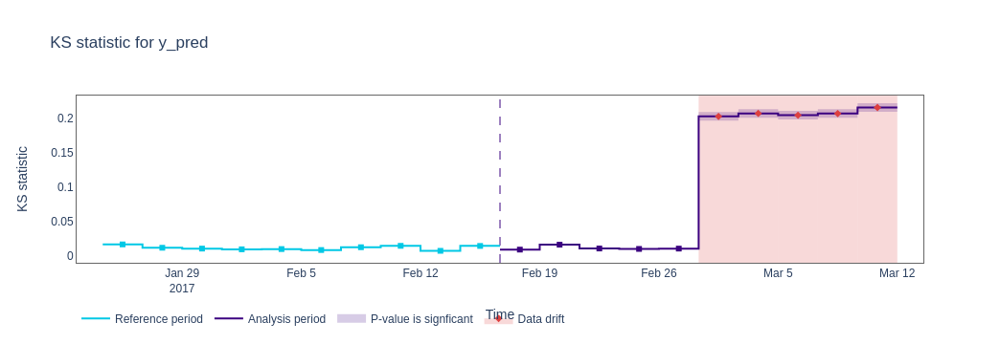

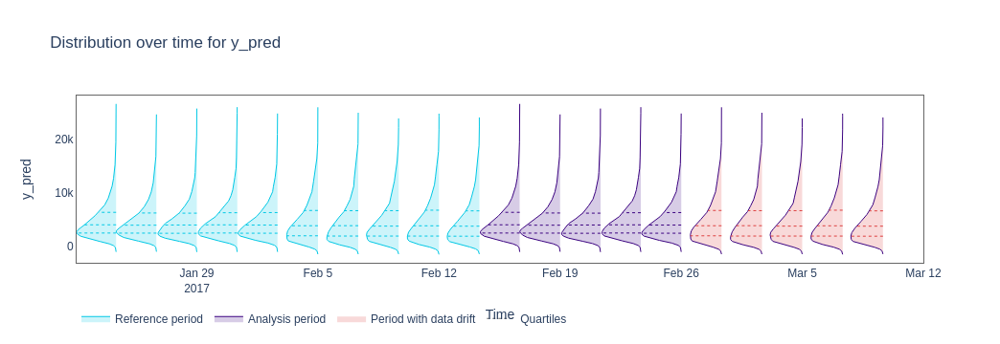

In [1]:
import nannyml as nml
import pandas as pd
from IPython.display import display

reference_df = nml.load_synthetic_car_price_dataset()[0]
analysis_df = nml.load_synthetic_car_price_dataset()[1]

display(reference_df.head())

calc = nml.StatisticalOutputDriftCalculator(
    y_pred='y_pred',
    timestamp_column_name='timestamp',
    problem_type='regression',
    chunk_size=6000
)

calc.fit(reference_df)
results = calc.calculate(analysis_df)
display(results.data)

prediction_drift_fig = results.plot(kind='prediction_drift', plot_reference=True)
prediction_drift_fig.show()

prediction_distribution_fig = results.plot(kind='prediction_distribution', plot_reference=True)
prediction_distribution_fig.show()

In [2]:
manually_extracted_quartile_values = [
    2460, 2442, 2412, 2461, 2422, 1936, 1892, 1890, 1888, 1864,
    2460, 2442, 2412, 2461, 2422, 1936, 1892, 1890, 1888, 1864
]

We observe that in the first chunks of the analysis period there seems to be some data drift.

But what about no drift being detected there? Let's verify the results by calculating quartiles manually.

In [3]:
chunker = nml.SizeBasedChunker(chunk_size=6000)

chunks1 = chunker.split(reference_df, timestamp_column_name='timestamp')
quantile1 = []

for chunk in chunks1:
    quantile1.append(
        chunk.data.y_pred.quantile(q=0.25)
    )

chunks2 = chunker.split(analysis_df, timestamp_column_name='timestamp')
quantile2 = []

for chunk in chunks2:
    quantile2.append(
        chunk.data.y_pred.quantile(q=0.25)
    )

In [4]:
quantile1 + quantile2

[2479.0,
 2416.75,
 2412.75,
 2442.0,
 2428.0,
 2459.75,
 2438.25,
 2430.0,
 2440.75,
 2433.0,
 2423.0,
 2521.0,
 2388.75,
 2478.75,
 2391.0,
 1205.0,
 1150.75,
 1172.0,
 1190.0,
 1121.0]

In [5]:
import matplotlib.pyplot as plt
import numpy as np

[]

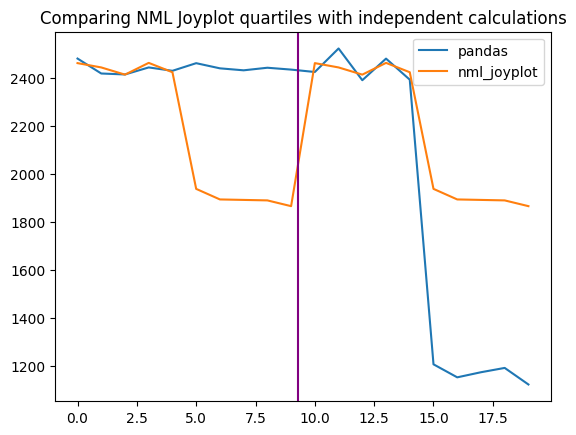

In [10]:
plt.title("Comparing NML Joyplot quartiles with independent calculations")
plt.plot(quantile1 + quantile2, label='pandas')
plt.plot(manually_extracted_quartile_values, label='nml_joyplot')
plt.axvline(x = 9.3, color='purple')
plt.legend()
plt.plot()

We note that the last 5 reference chunks have the same values as the last 5 analysis chunks!!!

Could the incorrect values be the average of correct ones for both sets?

In [7]:
_tst1 = (np.array(quantile1[-5:]) + np.array(quantile2[-5:]))/2
_tst1

array([1832.375, 1794.5  , 1801.   , 1815.375, 1777.   ])

In [8]:
manually_extracted_quartile_values[-5:]

[1936, 1892, 1890, 1888, 1864]

No, they don't match

Misc investigation cells below:

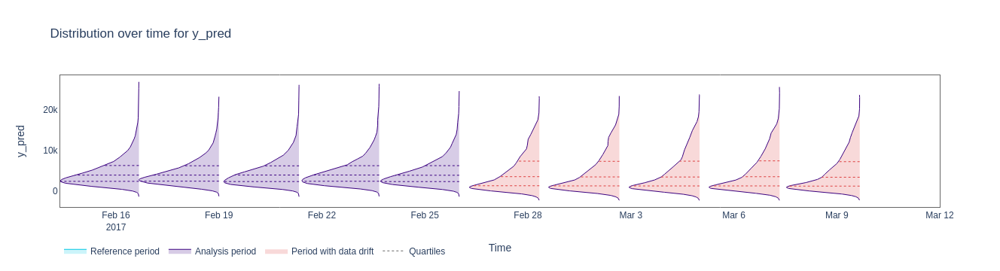

In [11]:
prediction_distribution_fig = results.plot(kind='prediction_distribution', plot_reference=False)
prediction_distribution_fig.show()

In [12]:
manually_analysis_quart = [
    2447, 2485, 2400, 2465, 2391, 1368, 1332, 1324, 1328, 1284
]

[]

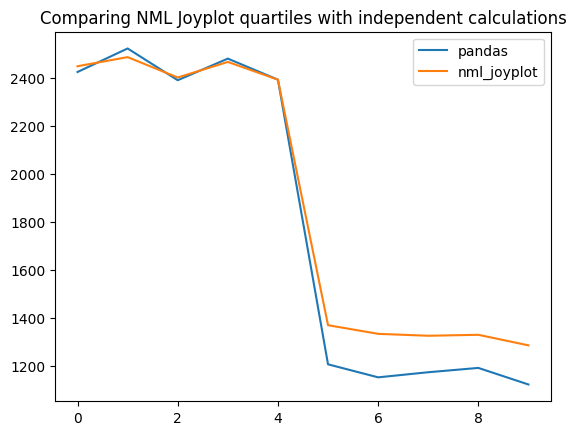

In [13]:
plt.title("Comparing NML Joyplot quartiles with independent calculations")
plt.plot(quantile2, label='pandas')
plt.plot(manually_analysis_quart, label='nml_joyplot')
# plt.axvline(x = 9.3, color='purple')
plt.legend()
plt.plot()

In [ ]:
from scipy.stats import ks_2samp
ks_2samp(reference_df.y_pred, chunks1[5].data.y_pred)

In [ ]:
reference_df.y_pred.describe()

In [ ]:
chunks1[-2].data.y_pred.plot.kde()
chunks2[1].data.y_pred.plot.kde()

In [ ]:
ks_2samp(reference_df.y_pred, chunks2[2].data.y_pred)

In [ ]:
chunks1[-1].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks2[-1].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))

In [ ]:
chunks2[0].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks2[-1].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))

In [ ]:
chunks1[5].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks2[0].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))

In [ ]:
# chunks1[4].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks1[5].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks1[4].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))

In [ ]:
ks_2samp(reference_df.y_pred, chunks1[4].data.y_pred)

In [ ]:
reference_df.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks1[5].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks1[4].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))
chunks1[3].data.y_pred.plot.kde(ind=np.arange(0, 20000, 100))